# PYTHON MINI PROJECT

### 68: Vidyut Chakrabarti

#### Solar flares are huge explosions of electromagnetic radiation from the Sun. They occur when the Sun's magnetic fields become tangled and release stored energy. Flares appear as a sudden, intense brightening of a region on the Sun, lasting several minutes to hours. 
#### These events can cause massive damage to Earth like destroying satellites, causing widespread blackouts due to their massive electromagnetic effects. 

In [1]:
import pandas as pd # For data manipulation and analysis
import numpy as np # For numerical operations
import matplotlib.pyplot as plt # For plotting
import seaborn as sns # For enhanced data visualization

In [2]:
# Reading the data from the CSV file into a Pandas DataFrame
data1=pd.read_csv("06.2-DATA SET FOR SOLAR FLARE PREDICTION.csv",delimiter=";")

# Displaying the shape of the DataFrame to understand its dimensions
data1.shape

(8874, 31)

In [3]:
# Displaying the first few rows of the DataFrame to get an overview of the data
data1.head()

,FlareNumber,T_REC,NOAA_AR,QUALITY,Longitude,Latitude,TOTUSJH,TOTBSQ,TOTPOT,TOTUSJZ,...,MEANGBT,MEANGBZ,MEANGBH,MEANJZH,TOTFY,MEANJZD,MEANALP,TOTFX,EPSY,EPSX
0,0,2010-05-01 23:48:00,11064,0,28,15,64.266,2.114200e+09,3.596094e+21,1.204115e+12,...,159.145,160.266,76.708,-0.012005,-349.33,1.697619,-0.031377,285.80,0.1567,-0.1282
1,0,2010-05-02 23:48:00,11064,0,15,16,37.787,1.392500e+09,1.230179e+21,7.821382e+11,...,152.084,158.553,66.027,-0.009381,-216.80,1.823444,-0.032041,7.22,0.1477,-0.0049
2,0,2010-05-03 23:48:00,11063,0,38,16,109.597,2.105100e+09,7.247206e+21,2.210139e+12,...,102.453,102.625,39.314,0.000564,-102.16,-0.383748,0.001854,-470.04,0.0460,0.2118
3,0,2010-05-03 23:48:00,11064,0,2,15,15.710,1.124900e+09,6.198173e+20,4.025928e+11,...,129.121,130.118,48.735,-0.002707,-152.54,1.768766,-0.014741,-123.05,0.1286,0.1037
4,0,2010-05-03 23:48:00,11065,0,16,32,36.136,9.150800e+08,2.181095e+21,9.585403e+11,...,103.869,104.104,31.943,-0.000633,181.19,0.107664,-0.003386,-191.06,-0.1878,0.1980


## DATASET DESCRIPTION:
#### T_REC: Contains date and time that the magnetic data were collected.
#### NOAA_AR: Shows the number of the active region where the event occurred (where the magnetic data were taken from).
#### QUALITY: This attribute refers to a flag from the SHARP's data set showing whether records are noisy.
#### LONGITUDE: This attribute shows the longitude in which the active region can be encountered in the solar surface.
#### LATITUDE: This attribute contains the latitude at which the active region can be found on the solar surface.
#### TOTUSJH: Total unsigned current helicity. This attribute and all the twenty four following attributes are the data from the Spaceweather HMI Active Region Patch (SHARP) data sets provided by the JSOC. They correspond to magnetic measurements and physical parameters derived from active regions that were automatically tracked by the HMI equipment.
##### TOTBSQ: Total magnitude of Lorentz force.
##### TOTPOT: Total photospheric magnetic free energy density.
##### TOTUSJZ: Total unsigned vertical current.
##### ABSNJZH: Absolute value of the net current helicity.
##### SAVNCPP: Sum of the absolute value of the net current per polarity.
##### USFLUX: Total unsigned flux.
##### AREA_ACR: Area of strong field pixels in the active region.
##### TOTFZ: Sum of z-component of Lorentz force.
##### MEANPOT:	Mean photospheric magnetic free energy.
##### R_VALUE:	Sum of flux near polarity inversion line.
##### EPSZ:	Sum of z-component of normalized Lorentz force.
##### SHRGT45:	Fraction of Area with shear >45°.
##### MEANSHR:	Mean shear angle
##### MEANGAM:	Mean angle of field from radial
##### MEANGBT:	Mean gradient of total field
##### MEANGBZ:	Mean gradient of vertical field
##### MEANGBH:	Mean gradient of horizontal field
##### MEANJZH:	Mean current helicity (Bz contribution)
##### TOTFY: Sum of y-component of Lorentz force
##### MEANJZD:	Mean vertical current density
##### MEANALP:	Mean characteristic twist parameter, α
##### TOTFX: Sum of x-component of Lorentz force
##### EPSY: Sum of y-component of normalized Lorentz force
##### EPSX:	Sum of x-component of normalized Lorentz force

In [4]:
# Initializing variables to count and track indices of rows with interference
count=0
ind=0
should_drop=[]

# Looping through the 'QUALITY' column to identify rows with interference
for i in data1['QUALITY']:
    if(i!=0):
        should_drop.append(ind) # Storing the index of rows with interference
        count+=1
    ind+=1
    
# Displaying information about the interference rows
print("""There are {} rows of data which have interference and need to be removed. 
They make up {} of the data.""".format(count,count/len(data1['QUALITY'])))

# Dropping rows with interference based on the stored indices
for i in should_drop:
    data1.drop(i,axis=0,inplace=True)
    
    
print("1st phase of cleansing complete. Deleted 182 rows of data.")

There are 182 rows of data which have interference and need to be removed. 
They make up 0.020509353166553976 of the data.
1st phase of cleansing complete. Deleted 182 rows of data.


In [5]:
# Displaying the count of NULL/NaN values in each column of the DataFrame
print(data1.isnull().sum())

print("We see that there are 15 values of MEANSHR which have NULL/NaN value.")

# Calculating the mean of the 'MEANSHR' column
meantotal_shr=data1['MEANSHR'].mean()

# Filling NULL/NaN values in the 'MEANSHR' column with the calculated mean
data1['MEANSHR'].fillna(value=meantotal_shr, inplace=True)

print("""Phase 2 of data cleansing complete. 
Replaced Null/NaN values with mean of row. """)

FlareNumber     0
T_REC           0
NOAA_AR         0
QUALITY         0
Longitude       0
Latitude        0
TOTUSJH         0
TOTBSQ          0
TOTPOT          0
TOTUSJZ         0
ABSNJZH         0
SAVNCPP         0
USFLUX          0
AREA_ACR        0
TOTFZ           0
MEANPOT         0
R_VALUE         0
EPSZ            0
SHRGT45         0
MEANSHR        15
MEANGAM         0
MEANGBT         0
MEANGBZ         0
MEANGBH         0
MEANJZH         0
TOTFY           0
MEANJZD         0
MEANALP         0
TOTFX           0
EPSY            0
EPSX            0
dtype: int64
We see that there are 15 values of MEANSHR which have NULL/NaN value.
Phase 2 of data cleansing complete. 
Replaced Null/NaN values with mean of row. 


In [6]:
# Converting the 'T_REC' column to datetime format using Pandas
data1['T_REC']=pd.to_datetime(data1['T_REC'])

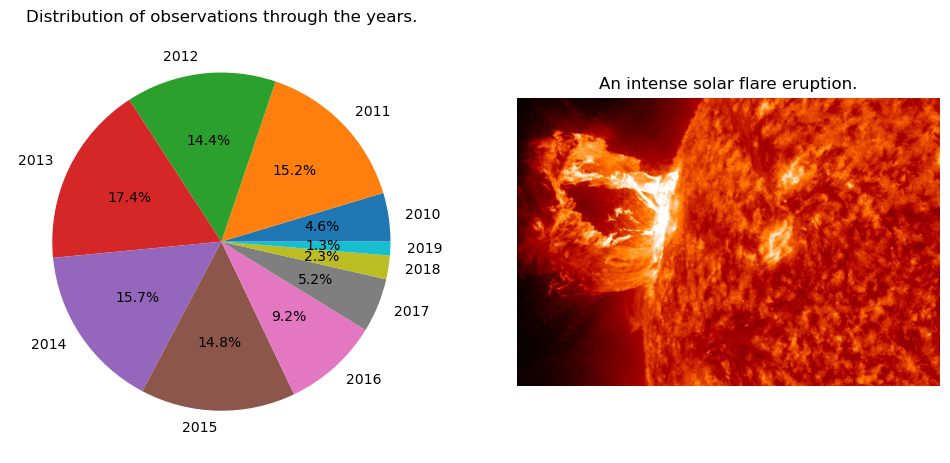

In [7]:
# Creating lists to store years and corresponding counts of observations
years=[]
counts=[]

# Extracting the year from each datetime value in the 'T_REC' column and storing in the 'years' list
for i in data1['T_REC']:
    years.append(i.year)
    
# Grouping the data by years and counting the number of observations for each year
grouped=data1.groupby(years)

# Storing the counts of observations for each year
for i in grouped.groups.keys():
    counts.append(len(grouped.groups[i]))
    
# Creating a pie chart to visualize the distribution of observations through the years
plt.figure(figsize=(12,10))
ax1=plt.subplot2grid((1, 2), (0, 0))
ax1.title.set_text('Distribution of observations through the years.')
plt.pie(counts, labels = grouped.groups.keys(),autopct="%1.1f%%")

# Displaying an image in the second subplot to represent an intense solar flare eruption
ax2=plt.subplot2grid((1, 2), (0, 1))
ax2.title.set_text('An intense solar flare eruption.')
plt.axis('off')
image = plt.imread('image.WEBP')
plt.imshow(image)
plt.show()

#### Description of dataset: FLARENUMBER 1 signifies a X or M class event. X-class flares are big; they are major events that can trigger radio blackouts around the whole world and long-lasting radiation storms in the upper atmosphere. M-class flares are medium-sized; they generally cause brief radio blackouts that affect Earth's polar regions. While a FLARENUMBER of 0 signifies A,B or C class flares which are generally smaller and do not pass through Earth's magnetic field.

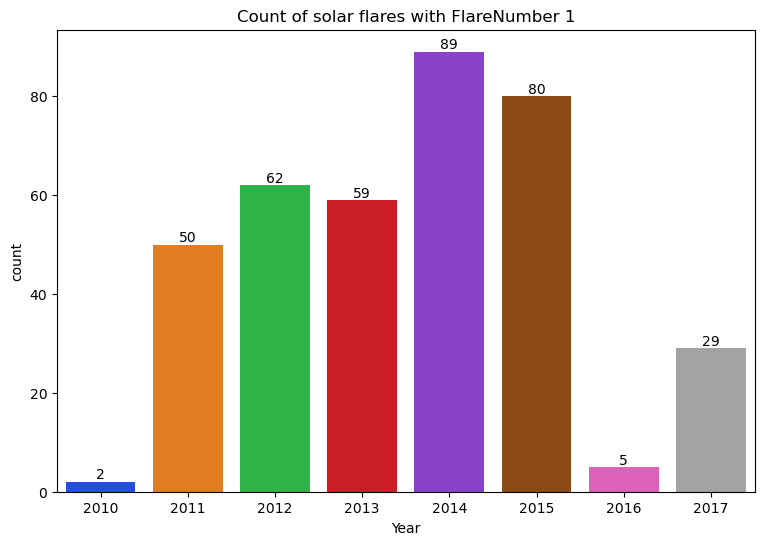

In [8]:
import warnings
warnings.filterwarnings('ignore')

# Creating a list to store years for solar flares with FlareNumber 1
years1=[]


# Filtering the DataFrame to include only rows with FlareNumber 1
df_flare1=data1[data1['FlareNumber']==1]

# Extracting the year from each datetime value in the filtered DataFrame and storing it in the 'years1' list
for i in df_flare1['T_REC']:
    years1.append(i.year)
    
# Creating a new column 'Year' in the filtered DataFrame to store the extracted years
df_flare1['Year']=years1
plt.figure(figsize=(9,6))
plt.title("Count of solar flares with FlareNumber 1")
graph=sns.countplot(x='Year',data=df_flare1,palette="bright")

# Adding labels to the bars in the plot with the count of solar flares for each year
graph.bar_label(graph.containers[0])
plt.show()

### ANALYSIS: 
#### We see that the maximum no. of solar flares were counted in the years of 2013-2015 marking the peak of sun's activity. NASA explains that solar flares become \"bigger and more common\" every 11 years, when the sun reaches its maximum activity in its cycle. Hence it will again reach its maximum in the period between 2024-2026.

<IPython.core.display.Javascript object>


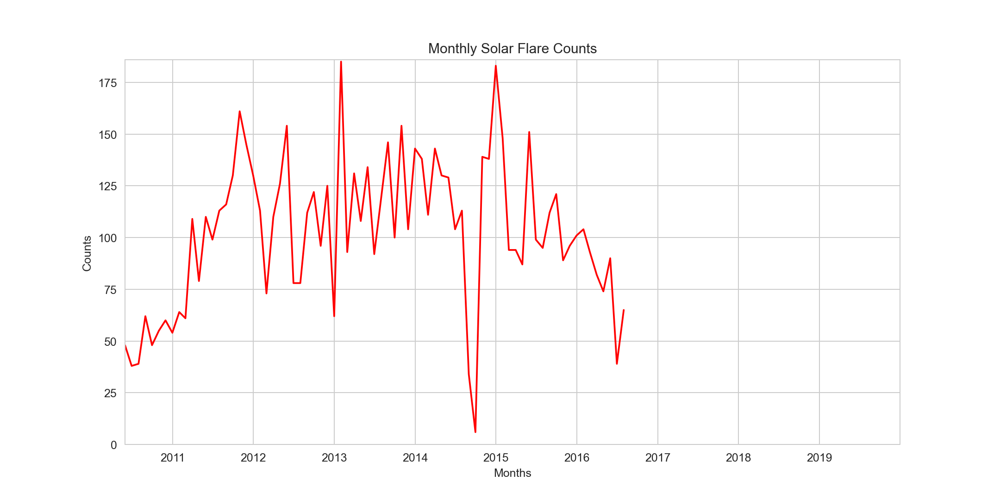

In [25]:
from matplotlib import animation
from matplotlib.animation import FuncAnimation
%matplotlib notebook

# Resampling the data to get monthly counts of solar flares
monthly_counts = data1.resample('M', on='T_REC').size()

# Finding the maximum count for setting y-axis limit
max_count=max(monthly_counts)

# Creating a figure and axis for the animated plot
fig, ax = plt.subplots(figsize=(12, 6))

def animate(i):
    ax.clear()  # clear the previous image
    ax.set_xlim([monthly_counts.index[0], monthly_counts.index[-1]])  # fix the x axis
    ax.set_ylim([0, max_count + 1])  # fix the y axis
    ax.plot(monthly_counts.index[:i + 1], monthly_counts.iloc[:i + 1], ls="-",color="r")
    ax.set_title('Monthly Solar Flare Counts')
    ax.set_xlabel('Months')
    ax.set_ylabel('Counts')

# Creating a FuncAnimation object for the animated plot
FuncAnimation(fig=fig,func=animate,frames=len(monthly_counts),interval=100,repeat=False)

The most active Latitude is 12, and the most active Longitude is 18.
However the most active region for recorded solar activity is:
Longitude: 23
Latitude: 17; which occur in pair 18 times.


<IPython.core.display.Javascript object>


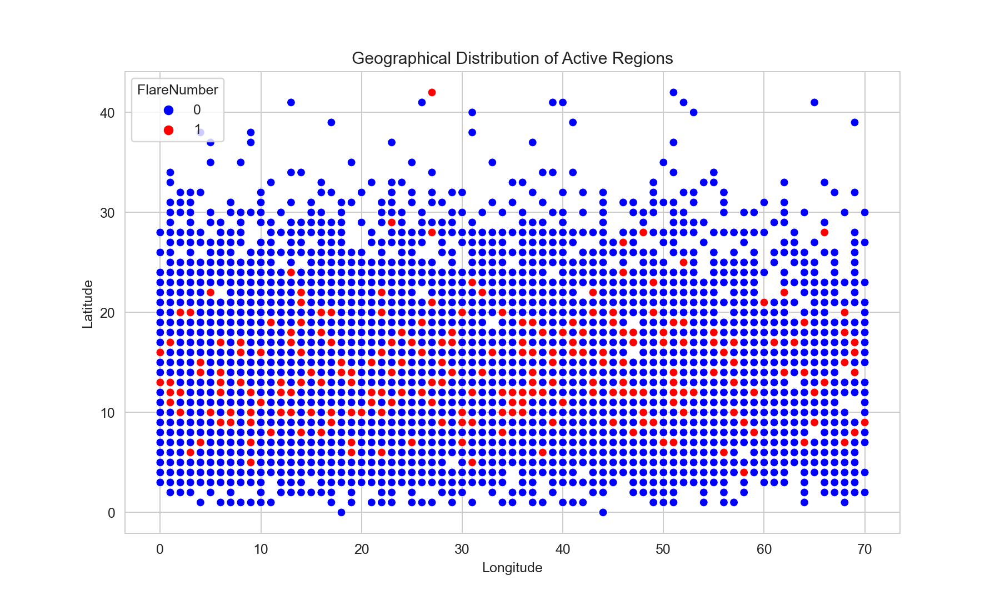

In [13]:
# Creating a DataFrame to store Longitude and Latitude columns from the original data
df_lat_long=pd.DataFrame({"Longitude": data1['Longitude'],
                        "Latitude": data1['Latitude']})

# Identifying duplicate Longitude and Latitude pairs
duplicate = df_lat_long[df_lat_long.duplicated()]

# Grouping duplicate pairs to find the most active region
grouped=duplicate.groupby(['Longitude','Latitude'])
large=0
for i in grouped.groups:
    leng=len(grouped.groups[i])
    if(leng>large):
        pair=i
        large=leng
        
# Displaying information about the most active Latitude and Longitude
print("The most active Latitude is {}, and the most active Longitude is {}.".format(data1['Latitude'].mode()[0],data1['Longitude'].mode()[0]))
print("However the most active region for recorded solar activity is:\nLongitude: {}\nLatitude: {}; which occur in pair {} times.".format(pair[0],pair[1],large))

# Geographical distribution of active regions
plt.figure(figsize=(10, 6))
sns.scatterplot(x='Longitude', y='Latitude', hue='FlareNumber', data=data1, palette=['blue', 'red'])
plt.title('Geographical Distribution of Active Regions')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.show()

<IPython.core.display.Javascript object>


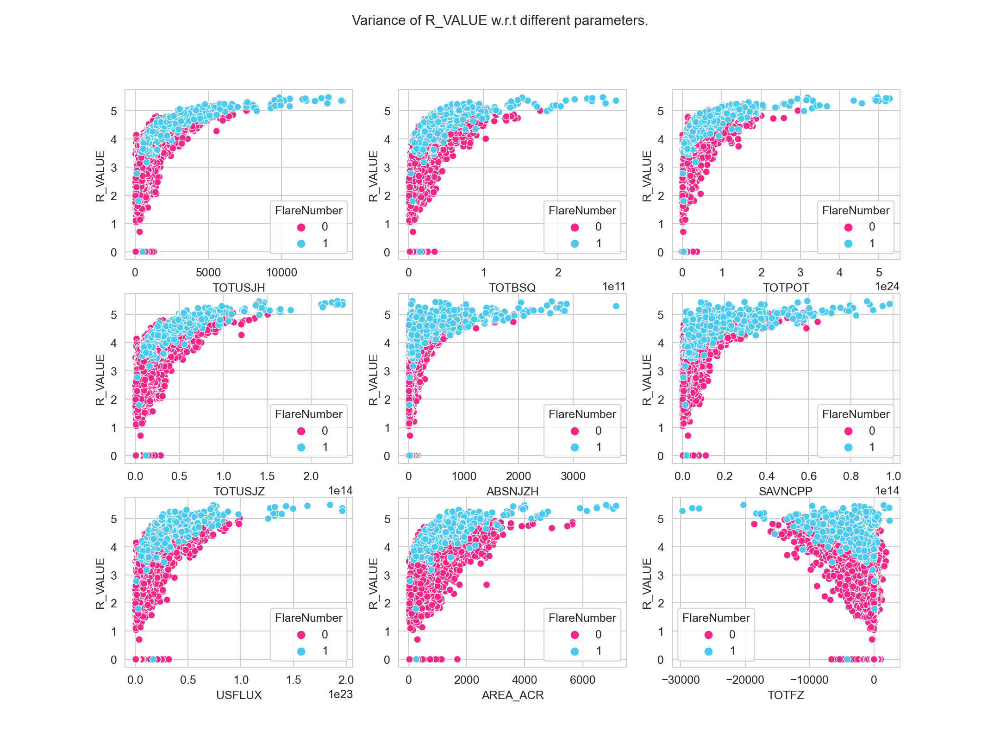

In [16]:
# Plotting the variance of R_VALUE with respect to different parameters
plt.figure(figsize=(12,9))
plt.suptitle("Variance of R_VALUE w.r.t different parameters.")
sns.set_style('whitegrid')

# Subplot 1
plt.subplot2grid((3, 3), (0, 0)) 
sns.scatterplot(x='TOTUSJH',y='R_VALUE',hue="FlareNumber",data=data1,palette=["#F72585","#4CC9F0"])

# Subplot 2
plt.subplot2grid((3, 3), (0, 1)) 
sns.scatterplot(x='TOTBSQ',y='R_VALUE',hue="FlareNumber",data=data1,palette=["#F72585","#4CC9F0"])

# Subplot 3
plt.subplot2grid((3, 3), (0, 2)) 
sns.scatterplot(x='TOTPOT',y='R_VALUE',hue="FlareNumber",data=data1,palette=["#F72585","#4CC9F0"])

# Subplot 4
plt.subplot2grid((3, 3), (1, 0)) 
sns.scatterplot(x='TOTUSJZ',y='R_VALUE',hue="FlareNumber",data=data1,palette=["#F72585","#4CC9F0"])  

# Subplot 5
plt.subplot2grid((3, 3), (1, 1)) 
sns.scatterplot(x='ABSNJZH',y='R_VALUE',hue="FlareNumber",data=data1,palette=["#F72585","#4CC9F0"])

# Subplot 6
plt.subplot2grid((3, 3), (1, 2)) 
sns.scatterplot(x='SAVNCPP',y='R_VALUE',hue="FlareNumber",data=data1,palette=["#F72585","#4CC9F0"])

# Subplot 7
plt.subplot2grid((3, 3), (2, 0)) 
sns.scatterplot(x='USFLUX',y='R_VALUE',hue="FlareNumber",data=data1,palette=["#F72585","#4CC9F0"])

# Subplot 8
plt.subplot2grid((3, 3), (2, 1)) 
sns.scatterplot(x='AREA_ACR',y='R_VALUE',hue="FlareNumber",data=data1,palette=["#F72585","#4CC9F0"])

# Subplot 9
plt.subplot2grid((3, 3), (2, 2)) 
sns.scatterplot(x='TOTFZ',y='R_VALUE',hue="FlareNumber",data=data1,palette=["#F72585","#4CC9F0"]) 
plt.show()

#### ANALYSIS: 1. We see that R_VALUE increase logarithmically w.r.t 8 out of 9 parameters and peaks of  at 6 
####                2. We also notice that R_VALUE remains high for solar flares of FLARENUMBER==1.
####                3. However R_VALUE behaves differently w.r.t TOTFZ. R_VALUE decreases as TOTFZ becomes positive.

<IPython.core.display.Javascript object>


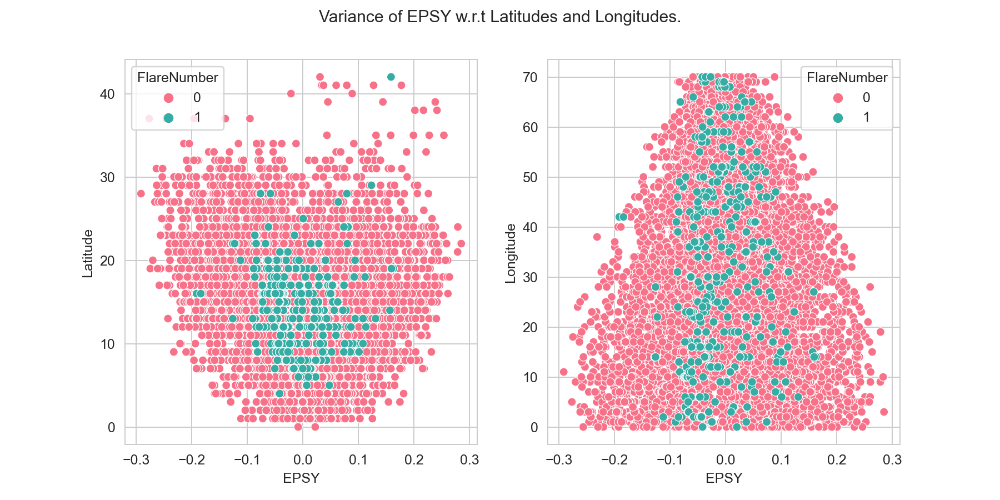

In [17]:
# Plotting the variance of EPSY with respect to Latitudes and Longitudes
plt.figure(figsize=(10,5))
plt.suptitle("Variance of EPSY w.r.t Latitudes and Longitudes.")
sns.set_style('whitegrid')

# Subplot 1: EPSY vs Latitude
plt.subplot2grid((1, 2), (0, 0))
sns.scatterplot(x='EPSY',y='Latitude',hue="FlareNumber",data=data1,palette="husl")

# Subplot 2: EPSY vs Longitude
plt.subplot2grid((1, 2), (0, 1))
sns.scatterplot(x='EPSY',y='Longitude',hue="FlareNumber",data=data1,palette="husl")
plt.show()

#### A very peculiar observation is made wherein we see the EPSY for the same latitudes and Longitudes for solar flares with FlareNumber 1 usually lie between -0.1 and 0.1 whereas EPSY for Flares categorized 0 lie outside the region of -0.1 to 0.1.

<IPython.core.display.Javascript object>


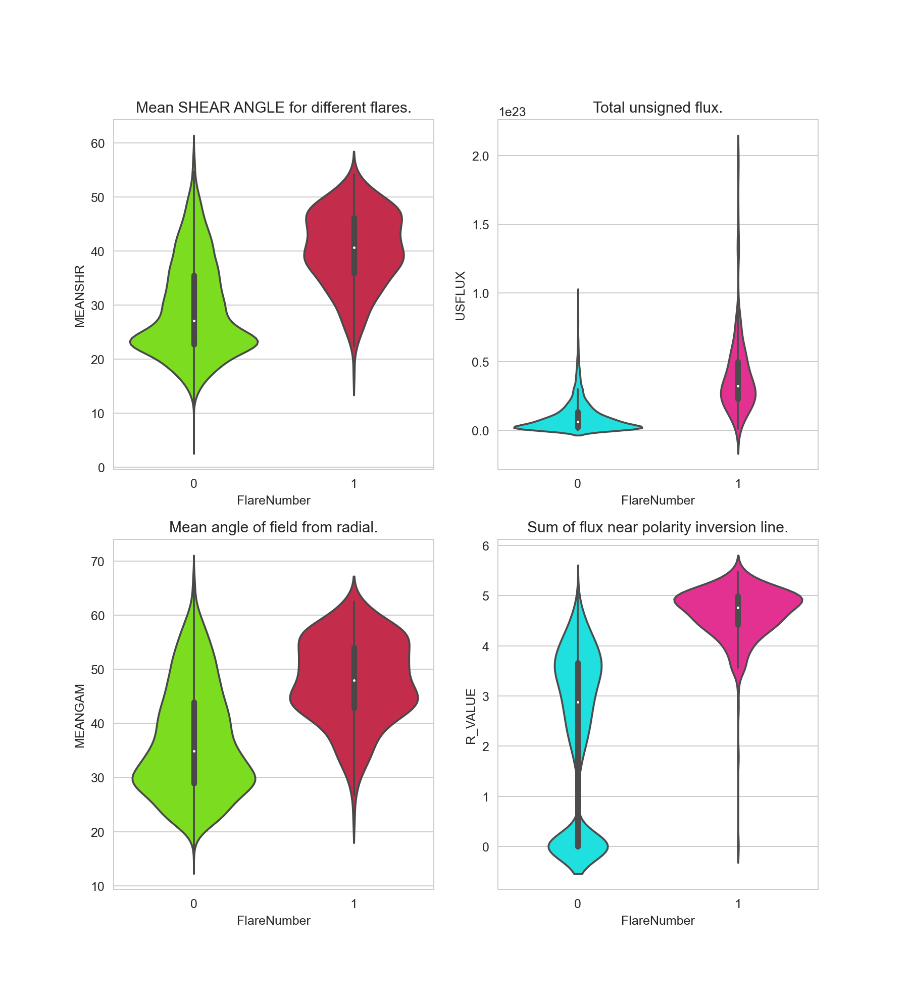

In [18]:
# Plotting violin plots to visualize the distribution of selected parameters for different flare categories
plt.figure(figsize=(10,11))

# Subplot 1: Mean SHEAR ANGLE for different flares
ax1=plt.subplot2grid((2, 2), (0, 0))
ax1.title.set_text("Mean SHEAR ANGLE for different flares.")
sns.violinplot(x='FlareNumber', y='MEANSHR', data=data1,palette=["lawngreen","crimson"])

# Subplot 2: Total unsigned flux
ax2=plt.subplot2grid((2, 2), (0, 1))
ax2.title.set_text("Total unsigned flux.")
sns.violinplot(x='FlareNumber', y='USFLUX', data=data1,palette=["cyan","deeppink"])

# Subplot 3: Mean angle of field from radial
ax3=plt.subplot2grid((2, 2), (1, 0))
ax3.title.set_text("Mean angle of field from radial.")
sns.violinplot(x='FlareNumber', y='MEANGAM', data=data1,palette=["lawngreen","crimson"])

# Subplot 4: Sum of flux near polarity inversion line
ax4=plt.subplot2grid((2, 2), (1, 1))
ax4.title.set_text("Sum of flux near polarity inversion line.")
sns.violinplot(x='FlareNumber', y='R_VALUE', data=data1,palette=["cyan","deeppink"])
plt.show()

#### INTERPRETATION: We see that by looking at some parameter ranges and calculating the probablity of their mean value of occurence we can figure out the intensity of solar storms. The width of the violins signify maximum values lie in that range.

<IPython.core.display.Javascript object>


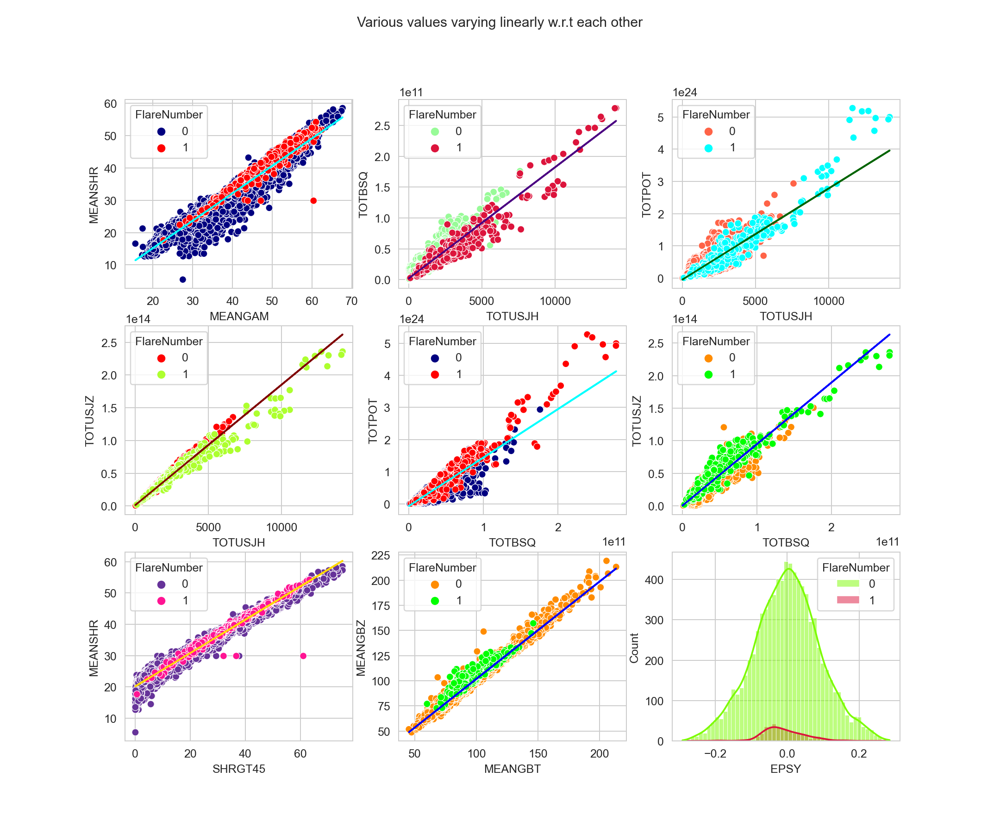

In [19]:
# Plotting various values varying linearly with respect to each other
from numpy.polynomial.polynomial import polyfit
plt.figure(figsize=(12,10))
plt.suptitle("Various values varying linearly w.r.t each other")
sns.set_style('whitegrid')

# Subplot 1: MEANSHR vs MEANGAM
plt.subplot2grid((3, 3), (0, 0)) 
b, m = polyfit(data1['MEANGAM'], data1['MEANSHR'], 1)
sns.scatterplot(x='MEANGAM',y='MEANSHR',data=data1,hue="FlareNumber",palette=["navy","red"])
plt.plot(data1['MEANGAM'], b + m * data1['MEANGAM'], '-',color="cyan")

# Subplot 2: TOTBSQ vs TOTUSJH
plt.subplot2grid((3, 3), (0, 1)) 
b, m = polyfit(data1['TOTUSJH'], data1['TOTBSQ'], 1)
sns.scatterplot(x='TOTUSJH',y='TOTBSQ',hue="FlareNumber",data=data1,palette=["palegreen","crimson"])
plt.plot(data1['TOTUSJH'], b + m *  data1['TOTUSJH'], '-',color="indigo")

# Subplot 3: TOTPOT vs TOTUSJH
plt.subplot2grid((3, 3), (0, 2))
b, m = polyfit(data1['TOTUSJH'], data1['TOTPOT'], 1)
sns.scatterplot(x='TOTUSJH',y='TOTPOT',hue="FlareNumber",data=data1,palette=["tomato","aqua"])
plt.plot(data1['TOTUSJH'], b + m *  data1['TOTUSJH'], '-',color="darkgreen")

# Subplot 4: TOTUSJZ vs TOTUSJH
plt.subplot2grid((3, 3), (1, 0)) 
b, m = polyfit(data1['TOTUSJH'], data1['TOTUSJZ'], 1)
sns.scatterplot(x='TOTUSJH',y='TOTUSJZ',hue="FlareNumber",data=data1,palette=["red","greenyellow"])
plt.plot(data1['TOTUSJH'], b + m *  data1['TOTUSJH'], '-',color="maroon")

# Subplot 5: TOTPOT vs TOTBSQ
plt.subplot2grid((3, 3), (1, 1)) 
b, m = polyfit(data1['TOTBSQ'], data1['TOTPOT'], 1)
sns.scatterplot(x='TOTBSQ',y='TOTPOT',hue="FlareNumber",data=data1,palette=["navy","red"])
plt.plot(data1['TOTBSQ'], b + m *  data1['TOTBSQ'], '-',color="aqua")

# Subplot 6: TOTUSJZ vs TOTBSQ
plt.subplot2grid((3, 3), (1, 2)) 
b, m = polyfit(data1['TOTBSQ'], data1['TOTUSJZ'], 1)
sns.scatterplot(x='TOTBSQ',y='TOTUSJZ',hue="FlareNumber",data=data1,palette=["darkorange","lime"])
plt.plot(data1['TOTBSQ'], b + m *  data1['TOTBSQ'], '-',color="blue")

# Subplot 7: MEANSHR vs SHRGT45
plt.subplot2grid((3, 3), (2, 0)) 
b, m = polyfit(data1['SHRGT45'], data1['MEANSHR'], 1)
sns.scatterplot(x='SHRGT45',y='MEANSHR',hue="FlareNumber",data=data1,palette=["rebeccapurple","deeppink"])
plt.plot(data1['SHRGT45'], b + m *  data1['SHRGT45'], '-',color="gold")

# Subplot 8: MEANGBZ vs MEANGBT
plt.subplot2grid((3, 3), (2, 1)) 
b, m = polyfit(data1['MEANGBT'], data1['MEANGBZ'], 1)
sns.scatterplot(x='MEANGBT',y='MEANGBZ',hue="FlareNumber",data=data1,palette=["darkorange","lime"])
plt.plot(data1['MEANGBT'], b + m *  data1['MEANGBT'], '-',color="blue")

# Subplot 9: Histogram of EPSY
plt.subplot2grid((3, 3), (2, 2)) 
sns.histplot(data = data1, x = "EPSY", kde = True, hue = "FlareNumber",palette=["lawngreen","crimson"])
plt.show()

#### ANALYSIS: We see that certain values depend linearly on each other and a linear regression model can be used to predict one value if the other value is known. Hence, we do not have to constantly monitor each of sun's parameters. Only knowing a few features at current time can help us make predictions about others. 

In [20]:
# Visualizing Solar Flare Activity over Time
import plotly.express as px

# Creating a scatter plot
fig = px.scatter(data1, x='T_REC', y='R_VALUE', color='FlareNumber', title='Solar Flare Activity over Time')

# Updating axis labels
fig.update_xaxes(title_text='Time')
fig.update_yaxes(title_text='R_VALUE')
fig.show()

print("1. The scatter plot visualizes the relationship between time (T_REC), R_VALUE, and FlareNumber.")
print("2. Each data point represents a solar flare event, with color indicating the FlareNumber category.")

1. The scatter plot visualizes the relationship between time (T_REC), R_VALUE, and FlareNumber.
2. Each data point represents a solar flare event, with color indicating the FlareNumber category.


#### ANALYSIS: The plot spans the entire dataset timeline, showing the distribution of solar flare events over time. No specific temporal pattern is immediately evident, suggesting varied solar activity across different periods. R_VALUE varies widely, reflecting the intensity of solar flares during different events. Higher R_VALUE values correspond to more intense solar flares.

<IPython.core.display.Javascript object>


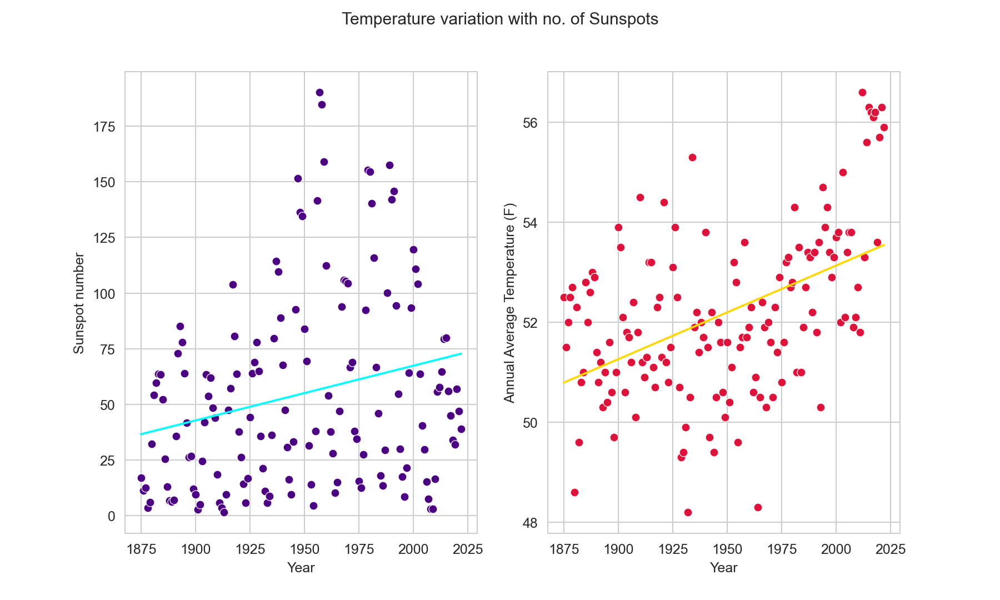

In [21]:
# Comparing Temperature Variation with Number of Sunspots Over Time
sunspot_data=pd.read_csv("suns_data.csv")
temp_data=pd.read_csv("Annual Average Temperature By Year.csv")


plt.figure(figsize=(10,6))
plt.suptitle("Temperature variation with no. of Sunspots")
sns.set_style('whitegrid')

# Subplot 1: Sunspot Number vs Year
plt.subplot2grid((1, 2), (0, 0)) 
b, m = polyfit(sunspot_data['Year'], sunspot_data['Sunspot number'], 1)
sns.scatterplot(x='Year',y='Sunspot number',data=sunspot_data,color="indigo")
plt.plot(sunspot_data['Year'], b + m * sunspot_data['Year'], '-',color="cyan")

# Subplot 2: Annual Average Temperature vs Year
plt.subplot2grid((1, 2), (0, 1)) 
b, m = polyfit(temp_data['Year'], temp_data['Annual Average Temperature (F)'], 1)
sns.scatterplot(x='Year',y='Annual Average Temperature (F)',data=temp_data,color="crimson")
plt.plot(temp_data['Year'], b + m *  temp_data['Year'], '-',color="gold")
plt.show()

#### ANALYSIS: We see that as years pass the number of sunspots or the active regions from where high solar activity is observed is steadily increasing and temperature on Earth has also been steadily increasing. Many researchers believe that these increasing sunspots are a cause of increased temperature and magnetic disturbances in Earth. 

<IPython.core.display.Javascript object>


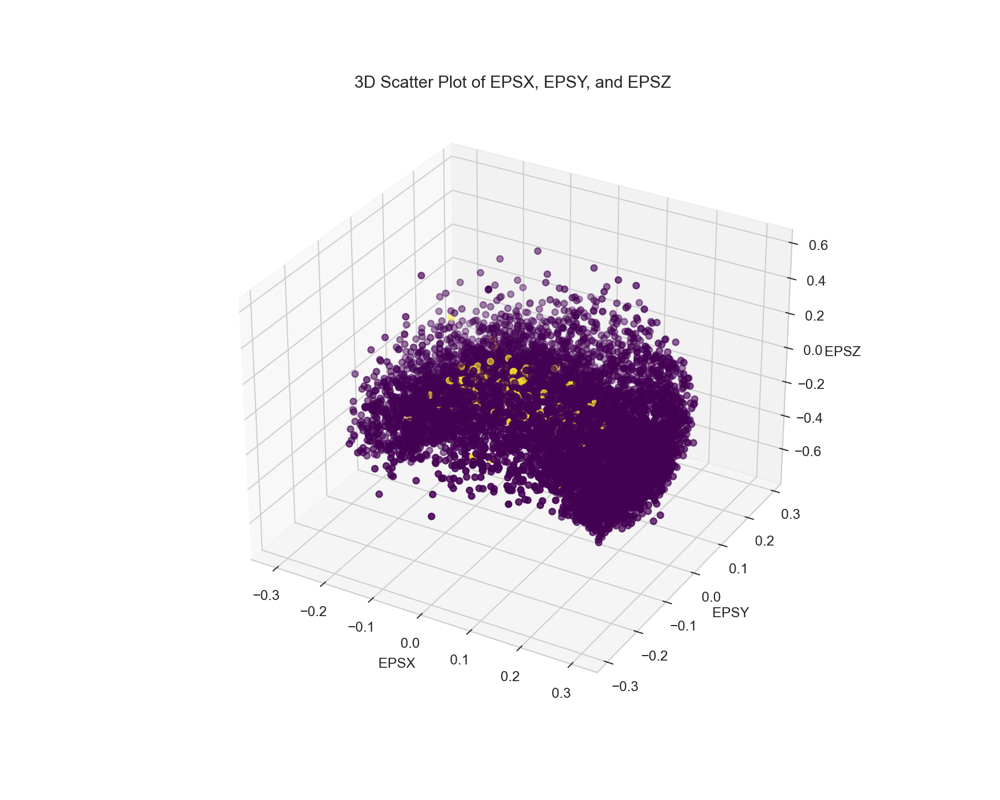

In [24]:
# Creating a 3D Scatter Plot of EPSX, EPSY, and EPSZ with FlareNumber Color Mapping
from mpl_toolkits.mplot3d import Axes3D

# Creating a 3D figure
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

# Scatter plot with color mapping based on FlareNumber
ax.scatter(data1['EPSX'], data1['EPSY'], data1["EPSZ"], c=data1['FlareNumber'], cmap="viridis")
ax.set_xlabel('EPSX')
ax.set_ylabel('EPSY')
ax.set_zlabel('EPSZ')
plt.title('3D Scatter Plot of EPSX, EPSY, and EPSZ')
plt.show()

In [23]:
parameters_to_analyze = [
    'TOTUSJH', 'TOTBSQ', 'TOTPOT', 'TOTUSJZ',
    'USFLUX', 'AREA_ACR',
    'TOTFZ',
    'MEANSHR', 'MEANGAM', 'MEANGBT', 'MEANGBZ', 'SHRGT45',
    'MEANJZH', 'TOTFY', 'MEANJZD', 'MEANALP', 'TOTFX', 'EPSY', 'EPSX'
]

# Descriptive Statistics for the Selected Parameters
print(data1.describe())

       FlareNumber       NOAA_AR  QUALITY    Longitude     Latitude  \
count  8692.000000   8692.000000   8692.0  8692.000000  8692.000000   
mean      0.043258  11917.292798      0.0    31.474229    14.378049   
std       0.203449    500.462828      0.0    19.017228     6.528200   
min       0.000000  11063.000000      0.0     0.000000     0.000000   
25%       0.000000  11474.000000      0.0    15.000000     9.000000   
50%       0.000000  11909.000000      0.0    31.000000    14.000000   
75%       0.000000  12373.000000      0.0    47.000000    18.000000   
max       1.000000  12754.000000      0.0    70.000000    42.000000   

            TOTUSJH        TOTBSQ        TOTPOT       TOTUSJZ      ABSNJZH  \
count   8692.000000  8.692000e+03  8.692000e+03  8.692000e+03  8692.000000   
mean     756.761160  1.582005e+10  1.686208e+23  1.532032e+13    86.962504   
std     1085.032349  2.045825e+10  3.313919e+23  2.018018e+13   205.402368   
min        0.001000  1.134300e+08  5.867828e+17 

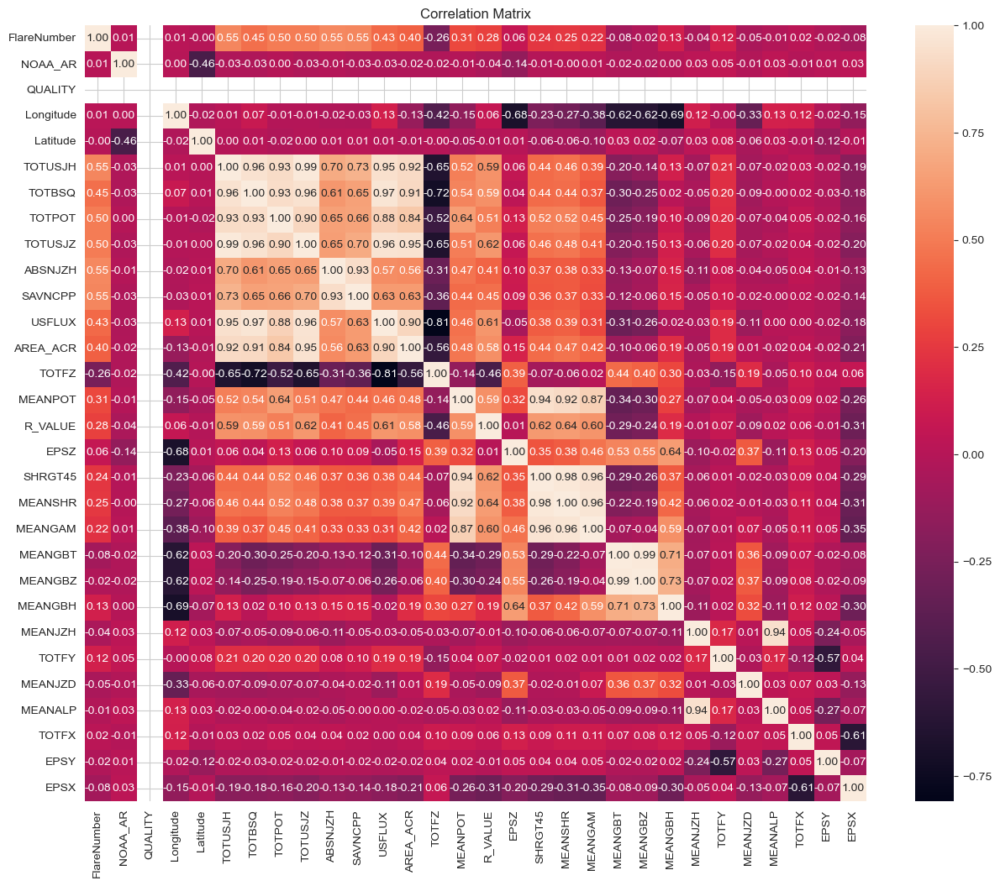

In [13]:
# Generating and Visualizing the Correlation Matrix
import warnings
warnings.filterwarnings('ignore')

# Calculating the Correlation Matrix
correlation_matrix = data1.corr()

# Creating a Heatmap for Visualization
plt.figure(figsize=(15, 12))
sns.heatmap(correlation_matrix, annot=True, fmt=".2f")
plt.title("Correlation Matrix")
plt.show()

#### PLOTS for every feature for reference and interpretation/observation of relations. (do not rerun this)

In [111]:
# Creating a Pair Plot to Visualize Relationships Among Features with FlareNumber Color Mapping
sns.pairplot(data1, hue ='FlareNumber')
plt.show()